# **Exploring Audio Features for Deceptive Storytelling Detection Using Machine Learning**

# **1. Author**

**Student Name**:  Erica Low Ee Zhin

**Student ID**: 231126519

# **2. Problem Formulation** 

Detecting deception is a vital yet complex challenge, with applications across various fields, ranging from law enforcement, police investigation, private consulting to psychological research.<sup>[1]</sup>  Traditional lie detection methods, such as polygraphs tests, have significant limitations as they rely on physiological measurements, like heartbeat, blood pressure, respiration and skin temperature.<sup>[1][2]</sup> This approach often fail to capture the nuanced nature of human deception, as one can supress physical signs of discomfort, leading to false conclusions. While previous research has extensively explored visual and behavioral cues, such as eye blink analysis, pupil dilation and facial expression analysis <sup>[2]</sup>, there is limited work on predicting deception purely based on speech data. 

With this, this project aims to fill this gap by developing a machine learning model to determine whether a narrated story is truthful or deceptive based soley on audio features. The problem of deceptive storytelling detection is framed as a binary classification task, with the labels of `true_story` and `deceptive_story`. However, raw audio signals, being high-dimensional data, pose challenges for direct analysis, as we will be operating in a predictor space consisting of hundreds of thousands of dimensions. 

To address this, we extract a set of four key audio features - Power, Pitch Mean, Pitch Standard Deviation, and Voice Fraction, which are extracted from 30-second segments of audio recordings. These features provide a manageable and informative predictor space for the model. Unlike polygraph tests, this non-invasive approach only requires only a short audio sample and can be performed without the need for specialized expertise such as polygraphists or psychologists. In addition to that, this approach also eliminates the reliance on physiological measures, providing a portable, more easily accessible tool for deception detection that individuals cannot easily manipulate. 

# **3. Methodology**

This section outlines the methology used in this project, including process of preparing the data, extracting features, creating datasets, evaluating models, and interpreting their performance for the deceptive storytelling detection task. 

#### **3.1 Data Preprocessing**
- The original dataset consists of 100 raw audio recordings, which were then further divided into several 30-second chunks based on the original audio file length to standardize input lengths. Any chunks shorter than 30 seconds were considered invalid and discarded.

- Each valid chunk was assigned a unique identifier (e.g., `00001.wav_chunk1`), and chunks originating from the same recording shared the same `File ID`. This traceability ensures statistical independence during data splitting.

- Sampling rates were recorded to ensure compatibility, and class distributions were monitored to maintain balance after splitting.

#### **3.2 Feature Extraction and Labels** 
- From each 30-second chunk, the following four audio features were extracted: 
  - **Power** : Represents the loudness of the audio.
  - **Pitch Mean** : Meaures the average highness or lowness of the sound.
  - **Pitch Standard Deviation** : Measures the pitch variability, distinguishing steady tones and shaky tones 
  - **Fraction of voiced region** : Represents the proportion of time the audio contains voiced sounds. 

- Labels were assigned to each chunk, where `true_story` was encoded as 0 and `deceptive_story` as 1.

- The File ID, extracted features, and labels were consolidated into a feature matrix, `features_df`. Each row represents a valid chunk, with columns for the File ID, four features, and label.

#### **3.3 Training Task**
- The training task involves using a processed dataset of 30-second audio chunks, with extracted features (power, pitch mean, pitch standard deviation, and voiced fraction) as inputs and binary labels (true_story=0 and deceptive_story=1) as outputs. The training and testing dataset was prepared as follows:

- **3.3.1 Train-Test Split**
  1. The dataset was split into 70% training and 30% testing subsets to evaluate the model’s performance on unseen data.

  2. Unique File IDs were identified and split using train_test_split.

  3. Training (`train_features_df`) and testing (`test_features_df`) subsets were created by selecting chunks based on their File ID from `features_df`, ensuring statistical independance across training and testing dataset.
  
  4. From these subsets, `X_train` and `X_test` were extracted, excluding `Label` and `File ID` columns, while `y_train` and `y_test` were derived from the `Label` column, where 0 represents `true_stiry` and 1 for `deceptive_story`.

- **3.3.2 Model Training**
  - Four classifiers (Logistic Regression, Random Forest, Gradient Boosting, SVM) are fitted with the training dataset.

  - In the model training, the methodology includes feature scaling, hyperparameter tuning (using GridSearchCV), and selecting the best model based on mean validation F1 scores.

  - Training F1 scores are calculated to assess the model's fit to the training data.

  - For feature scaling, the pipeline integrates StandardScaler to standardize features during model training, ensuring that all features contribute equally to the model.

#### **3.4 Validation Task**
- To tune hyperparameters and evaluate model performance reliably, the training set is further divided into training and validation subsets using stratified group cross-validation. This is to ensure a balanced class distributions and statistical independance across training and validation set. The cross-validation dataset was prepared as follow:

  1. StratifiedGroupKFold was used with File ID as the grouping criterion to prevent chunks from the same audio file from being split across training and validation sets.

  2. Five cross-validation folds were created, and indices for training (`train_idx`) and validation (`valid_idx`) splits were generated.

  3. For each fold, features (`X_cv_train`, `X_cv_valid`) and labels (`y_cv_train`, `y_cv_valid`) were extracted based on the indices.

  4. Validation F1 scores are calculated for each fold, and the mean score is usde for model evaluation.

  5. Average class distributions across all folds were also computed and displayed to verify balance.

#### **3.5 Performance Metrics**
- The primary metric (F1 Score) is explained in terms of its importance for balancing precision and recall. 

- Mean validation F1 scores across folds are used to select the best model, ensuring robust evaluation and fair comparisons during hyperparameter tuning.

- After the final model is fitted to the unseen dataset, a test F1 score is computed as well as a normalized confusion matrices to provide an additonal insights to the model performace on: true positives (correctly identified deceptive); true negatives (correctly identified true),false positives (true misclassified as deceptive), false negatives (deceptive misclassified as true).

#### **3.6 Model Testing**
- The best performing model is chosen based on the highest mean validation F1 score and is evaluated on the unseen testing dataset, with the steps following: 

  1. The test dataset (`X_test`, `y_test`) was scaled using the same scaling parameters as during training to ensure consistency.

  2. Predictions were made using the best model optimized with hyperparameters (validated in the validation task).

  3. The testing F1 score was calculated as the primary metric to assess the model’s generalization ability.
  
  4. A normalized confusion matrix is provided for further insights into classification accuracy and errors.


# **4. Implemented ML prediction pipelines**
This section describes the overview of the machine learning (ML) prediction pipelines implemented for the audio-based deception detection. The details of the stages are described in section 4.1 Transformation Stage and 4.2 Model Stage.

#### **Pipeline Overview**
1. The pipeline starts with using a 30s valid chunk of audio file which has been preprocessed before hand from the 100 raw recordings with various duration. 

2. A total of four audio features were extracted from the each individual 30s chunks, including power, pitch mean, pitch standard deviation, and voiced fraction. These features are selected for their relevance to detecting deceptive behavior. Then all these features are combined into a feature matrix for subsequent input for the model stage.

3. The intermediate output after the feature extraction is a feature matrix where, the rows represent individual 30s valid audio chunks, while the columns contain four extracted features, the `File ID`, and the corresponding binary label.

4. Then, a pipeline combining a StandardScaler and a machine learning classifier is constructed for each model. The classifiers including, Logistic Regression, Random Forest, Gradient Boosting and Support Vector Machines (SVM).

5. Each pipeline is optimized using GridSearchCV with the precomputed cross-validation splits, selecting the best hyperparameters based on the highest mean validation F1 score.

6. The intermediate output after the model stage are: 
    - A summary of training and validation F1 scores for each model.
    - Best hyperparameters for each classifier.
    - Bar charts visualizing model performance across metrics.

7. The best-performing model, determined by validation F1 score, is applied to the unseen testing dataset. Before testing, the features in the test set are standardized using the scaler fitted on the training data. The final output of this pipeline is the F1 score of the test set and a normalised confusion matrix is generated and analysed.

## **4.1 Transformation Stage**
This section outlines the transformation stage, detailing the input and output, and explaining the rationale behind the chosen preprocessing and feature extraction methods.


### **4.1.1 Input:**
- 100 raw audio files labeled with their corresponding File ID, Language, and Story Type (true_story or deceptive_story), stored in the `MLEND_df` dataframe.

### **4.1.2 Audio Chunking:**
- Each raw audio file is divided into 30-second chunks to standardize input length for feature extraction and model training.
- Chunks shorter than 30 seconds are discarded to ensure consistency in input duration and to prevent bias caused by shorter chunks having different statistical properties.
- Metadata such as total duration, sample rate, total number of chunks, valid chunks are recorded.
- Intermediate output: A `file_metadata` dataframe that summarizes the raw audio statistics for each file, including File ID, Duration(s), Sample Rate, Total Chunks, Valid Chunks (30s), and Story Type. Another dataframe, `chunk_df` containing only valid 30s chunks, with columns for File ID, Chunk ID, and Story Type.

### **4.1.3 Features Extraction and Labelling:**
- In this section, each valid 30s chunks in the `chunk_df` undergo feature extraction to derive four key audio features to reduce the dimensionality of raw signals while retaining critical patterns.: 
  - **Power**: Measures the energy of the audio signal to capture intensity patterns.
  - **Pitch Mean and Standard Deviation**: Statistical measures of pitch to capture frequency variations relevant to storytelling dynamics.
  - **Voiced Fraction**: Proportion of time the audio contains voiced sounds, which is important for speech analysis.
- The story types (true_story and deceptive_story) are encoded as label of 0 and 1, respectively in each valid chunks.

### **4.1.4 Output:**
- A feature matrix saved as `extracted_features.csv`, where each row represents a valid chunk, with columns for the four features, File ID, and the corresponding label.
- This CSV storage is to reduce processing time by avoiding redundant feature extraction during multiple runs.

## **4.2 Model Stage**

This stage focuses on building the machine learning models to classify audio chunks as either truthful (`0`) or deceptive (`1`). Four machine learning models were selected, each offering unique strengths and providing a diverse set of perspectives on the data. The objective was to achieve robust performance across models and to select the best-performing one based on cross-validated F1 scores.

### **4.2.1 Reasons for Classifiers Chosen**
Each model was chosen based on its specific characteristics, making it suitable for analyzing audio data:

- **Logistic Regression**:
  - Acts as a baseline model to assess whether the dataset is linearly separable.
  - Offers interpretability and quick implementation, enabling a straightforward comparison with more complex models.

- **Random Forest**:
  - A non-linear ensemble model capable of capturing intricate feature interactions.
  - Robust to outliers and less prone to overfitting when tuned properly.

- **Gradient Boosting**:
  - A boosting algorithm that builds strong classifiers by combining weak learners iteratively.
  - Suitable for datasets with slight imbalances just like our chunk dataset which consists of 52% true stories and 48% deceptive, as it optimizes performance at every iteration.
  - Provides high flexibility through hyperparameters like learning rate and maximum depth.

- **Support Vector Machine (SVM)**:
  - A powerful classifier effective for smaller datasets and high-dimensional feature spaces.
  - Well-suited for detecting complex, non-linear relationships in extracted audio features like pitch variability and voiced fraction.

### **4.2.2 Hyperparameter Optimization**
To achieve optimal performance, hyperparameter tuning was performed using GridSearchCV, with a custom cross-validation split (StratifiedGroupKFold) to ensure no data leakage and balanced class distributions. The parameter grids for each model are detailed below:

- **Logistic Regression<sup>[3]</sup>**:
  - `C`: Inverse of regularization strength, with values ranging from 0.1 to 100.
  - `max_iter`: Maximum iterations for solvers to converge, ranging from 100 to 500.

- **Random Forest<sup>[4]</sup>**:
  - `n_estimators`: Number of trees in the forest, ranging from 10 to 200.
  - `max_depth`: Maximum depth of each tree, ranging from 3 to 30.

- **Gradient Boosting<sup>[5]</sup>**:
  - `n_estimators`: Number of boosting stages, ranging from 10 to 100.
  - `max_depth`: Maximum depth of individual trees, ranging from 3 to 7.
  - `learning_rate`: Shrinks the contribution of each tree, with values ranging from 0.01 to 1.0.

- **Support Vector Machine (SVM)<sup>[6]</sup>**:
  - `C`: Regularization parameter, ranging from 0.1 to 20.
  - `kernel`: Specifies the kernel type; with options "linear" or "rbf".
  - `gamma`: Kernel coefficient, with options "scale" or "auto", which determine the influence of individual data points.

# **5. Dataset**

The datasets for this project are based on the MLEnd Deception Dataset, which consists of 100 audio recordings, each labeled as either `true_story` or `deceptive_story`. Below, we describe the datasets, the process of building them,  and any limitations observed.


## **5.1 Audio Dataset**
### **5.1.1 Original Data**:
- The datasets are derived from the MLEnd Deception Dataset, which can be installed in four steps:
   1. *Install the Required Library*:
      ```python
      pip install mlend==1.0.0.4
      ```
   2. *Import Library and Functions*:
       ```python
       import mlend
       from mlend import download_deception_small, deception_small_load
       ```
   3. *Download Small Data*:
       ```python
       datadir = download_deception_small(save_to='MLEnd', subset={}, verbose=1, overwrite=False)
       ```
   4. *Read File Paths*:
       ```python
       base_path = './MLEnd/deception/MLEndDD_stories_small/'
       MLEND_df = pd.read_csv('./MLEnd/deception/MLEndDD_story_attributes_small.csv').set_index('filename')
       ```
- In the code below, the MLEnd Deception Dataset (`MLEND_df`) consists of 100 audio files equally distributed between `true_story` and `deceptive_story` (50 files each).

- These stories are narrated in 16 languages, with English being the most common, representing 78 files, followed by other languages as shown in `language_df` as shown below.

In [2]:
#Data Loading 
import pandas as pd

base_path = './MLEnd/deception/MLEndDD_stories_small/'
MLEND_df = pd.read_csv('./MLEnd/deception/MLEndDD_story_attributes_small.csv').set_index('filename')
files = [base_path + file for file in MLEND_df.index]
display(MLEND_df.head())

#Data Distribution
story_type_counts = MLEND_df['Story_type'].value_counts()
print(story_type_counts)

#Langauge Distribution
language_counts = MLEND_df['Language'].value_counts()
language_df = pd.DataFrame(language_counts)
print("\nLanguages narrated in the dataset are:")
display(language_df)

,Language,Story_type
filename,,
00001.wav,Hindi,deceptive_story
00002.wav,English,true_story
00003.wav,English,deceptive_story
00004.wav,Bengali,deceptive_story
00005.wav,English,deceptive_story


Story_type
deceptive_story    50
true_story         50
Name: count, dtype: int64

Languages narrated in the dataset are:


,count
Language,
English,78
Hindi,4
Arabic,3
"Chinese, Mandarin",2
Marathi,2
Bengali,1
Kannada,1
French,1
Russian,1


### **5.1.2 Audio Metadata and Chunks Dataset**:
  - Each audio file was split into 30-second chunks, as the input audio for the model requires 30-s audio file. Chunks shorter than 30 seconds were discarded to maintain consistency.

  - Valid chunks were assigned unique identifiers in the format "FileID_ChunkID" (e.g., "00001.wav_chunk1").

  - Metadata, `metadata_df`, was created to track the file ID, total duration, valid chunk count, story type, and original sampling rate for each audio file.

  - The valid chunks were stored in `chunks_df`, containing the file ID, chunk ID, chunk data, story type (`true_story` or `deceptive_story`) and the sample rate for each chunk.

  - A total of 420 valid chunks were created, with 219 labeled as "true_story" and 201 labeled as "deceptive_story", resulting in a class distribution of approximately 52% and 48%, respectively.

In [3]:
import librosa
import pandas as pd
from tqdm import tqdm

metadata_rows = []
chunk_rows = []

for file_id in tqdm(MLEND_df.index):
    file_path = base_path + file_id
    story_type = MLEND_df.loc[file_id, 'Story_type']

    audio_data, original_sr = librosa.load(file_path, sr=None)

    # Total duration and chunk size
    total_duration = len(audio_data) / original_sr
    chunk_size = int(30 * original_sr)  # 30 seconds in samples

    # Split the audio into chunks
    chunks = [audio_data[i:i + chunk_size] for i in range(0, len(audio_data), chunk_size)]
    valid_chunks = [chunk for chunk in chunks if len(chunk) == chunk_size]

    # Metadata
    metadata_rows.append({"File ID": file_id,
                          "Total Duration (s)": total_duration,
                          "Total Chunks": len(chunks),
                          "Valid Chunks": len(valid_chunks),
                          "Story Type": story_type,
                          "Original Sample Rate": original_sr})

    # Valid Chunks
    for i, chunk in enumerate(valid_chunks):
        chunk_rows.append({"File ID": file_id,
                           "Chunk ID": f"{file_id}_chunk{i + 1}",
                           "Chunk Data": chunk,
                           "Story Type": story_type,
                           "Sample Rate": original_sr})

# Convert to DataFrames
metadata_df = pd.DataFrame(metadata_rows)
chunks_df = pd.DataFrame(chunk_rows)

# Display Results
print("Summary of Audio Files:")
display(metadata_df)
print("\nSummary of Valid Audio Chunks:")
display(chunks_df)

# Summary Statistics
print("\nSummary Statistics:")
print(f"Total Files Processed: {len(metadata_df)}")
print(f"Total Chunks Created: {metadata_df['Total Chunks'].sum()}")
print(f"Total Valid Chunks (30s): {metadata_df['Valid Chunks'].sum()}")
print(f"Unique Sample Rates: {metadata_df['Original Sample Rate'].unique()}")

# True and Deceptive Story Distribution
valid_chunk_labels = chunks_df['Story Type'].value_counts()
print("\nCount of True and Deceptive Stories from Valid Chunks (30s):")
for story_type, count in valid_chunk_labels.items():
    print(f"{story_type}: {count} chunks")

100%|██████████| 100/100 [00:06<00:00, 15.31it/s]

Summary of Audio Files:


,File ID,Total Duration (s),Total Chunks,Valid Chunks,Story Type,Original Sample Rate
0,00001.wav,122.167256,5,4,deceptive_story,44100
1,00002.wav,125.192018,5,4,true_story,44100
2,00003.wav,162.984127,6,5,deceptive_story,44100
3,00004.wav,121.681270,5,4,deceptive_story,44100
4,00005.wav,134.189751,5,4,deceptive_story,44100
...,...,...,...,...,...,...
95,00096.wav,111.512063,4,3,deceptive_story,44100
96,00097.wav,185.731224,7,6,true_story,44100
97,00098.wav,128.252766,5,4,deceptive_story,44100
98,00099.wav,132.412562,5,4,true_story,44100



Summary of Valid Audio Chunks:


,File ID,Chunk ID,Chunk Data,Story Type,Sample Rate
0,00001.wav,00001.wav_chunk1,"[1.5258789e-05, 1.5258789e-05, 3.0517578e-05, ...",deceptive_story,44100
1,00001.wav,00001.wav_chunk2,"[0.027450562, 0.026519775, 0.025390625, 0.0242...",deceptive_story,44100
2,00001.wav,00001.wav_chunk3,"[-0.00091552734, -0.0011138916, -0.0013122559,...",deceptive_story,44100
3,00001.wav,00001.wav_chunk4,"[6.1035156e-05, 9.1552734e-05, 7.6293945e-05, ...",deceptive_story,44100
4,00002.wav,00002.wav_chunk1,"[0.0008239746, 0.0008239746, 0.00088500977, 0....",true_story,44100
...,...,...,...,...,...
415,00099.wav,00099.wav_chunk4,"[-3.0517578e-05, -3.0517578e-05, -3.0517578e-0...",true_story,44100
416,00100.wav,00100.wav_chunk1,"[-0.00018310547, -0.00015258789, -6.1035156e-0...",deceptive_story,44100
417,00100.wav,00100.wav_chunk2,"[0.0004272461, 0.00048828125, 0.0005187988, 0....",deceptive_story,44100
418,00100.wav,00100.wav_chunk3,"[6.1035156e-05, 0.0, -6.1035156e-05, -6.103515...",deceptive_story,44100



Summary Statistics:
Total Files Processed: 100
Total Chunks Created: 520
Total Valid Chunks (30s): 420
Unique Sample Rates: [44100 48000]

Count of True and Deceptive Stories from Valid Chunks (30s):
true_story: 219 chunks
deceptive_story: 201 chunks


  - The `chunk_data` in `chunks_df` is the raw audio signals (amplitude values) for each 30-second chunk of the audio file. These values represent the waveform of the audio, essentially describing how the sound's amplitude changes over time.
  
  - The code below displays the first audio file in its full length and its valid 30-seconds chunks .

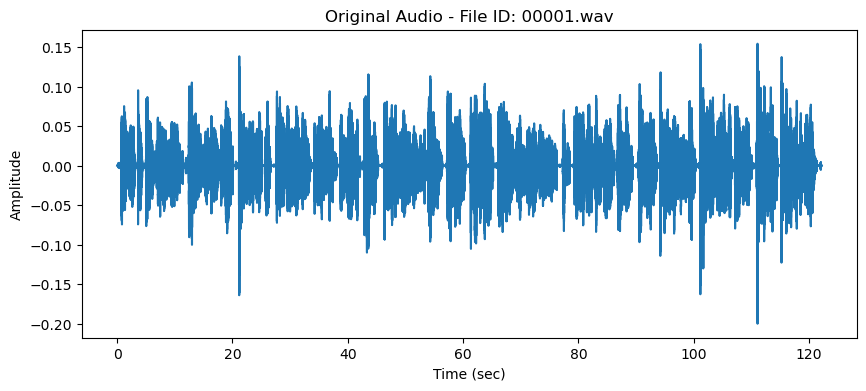

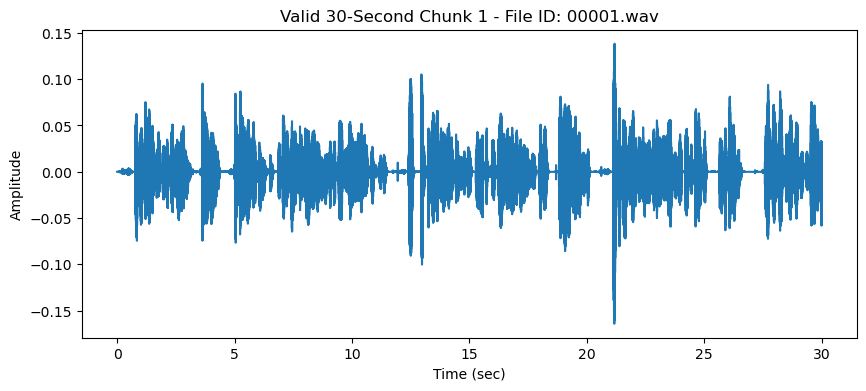

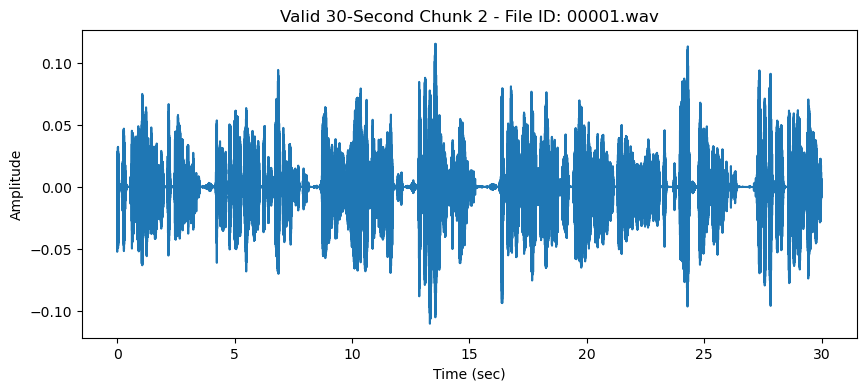

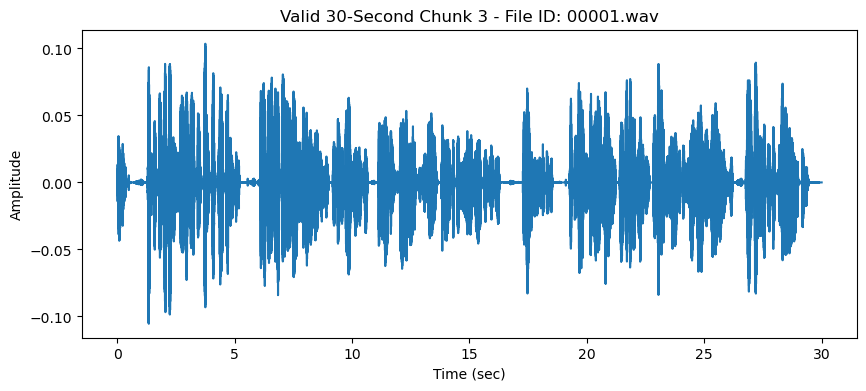

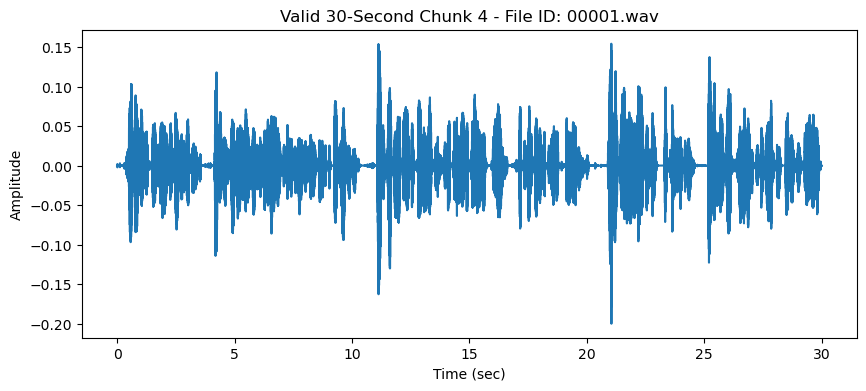

In [13]:
import numpy as np
import matplotlib.pyplot as plt
import librosa
import IPython.display as ipd

n = 0
file_id = MLEND_df.index[n]
file_path = base_path + file_id

x, sr = librosa.load(file_path, sr=None) 
t = np.arange(len(x)) / sr

plt.figure(figsize=(10, 4))
plt.plot(t, x)
plt.xlabel('Time (sec)')
plt.ylabel('Amplitude')
plt.title(f"Original Audio - File ID: {file_id}")
plt.show()
display(ipd.Audio(file_path))

# 30-second chunks
chunk_size = int(30 * sr) 
chunks = [x[i:i + chunk_size] for i in range(0, len(x), chunk_size)]
valid_chunks = [chunk for chunk in chunks if len(chunk) == chunk_size]

for i, chunk in enumerate(valid_chunks):
    t_chunk = np.arange(len(chunk)) / sr
    plt.figure(figsize=(10, 4))
    plt.plot(t_chunk, chunk)
    plt.xlabel('Time (sec)')
    plt.ylabel('Amplitude')
    plt.title(f"Valid 30-Second Chunk {i + 1} - File ID: {file_id}")
    plt.show()
    display(ipd.Audio(chunk, rate=sr))


## **5.2 Feature Dataset**
- For each valid chunk, four audio features were extracted:
  - **Power**: Measures the energy of the audio signal.
  - **Pitch Mean**: Represents the average pitch of the audio.
  - **Pitch Standard Deviation**: Captures variations in pitch.
  - **Voiced Fraction**: Proportion of time the audio contains voiced sounds.
  
- Before extracting the features, the audio amplitudes in each chunks are scaled as amplitude values in raw audio recordings can vary significantly based on recording conditions.

- Scaling the amplitude normalizes these differences, ensuring that features are calculated consistently across all audio samples. This prevents the model from being biased by arbitrary differences in amplitude levels.

- Chunks labeled as `true_story` were encoded as `0`, and `deceptive_story` as `1`.

- These features were combined into `X` (features) and `y` (labels).

- A features dataframe, `features_df`, was created where each row corresponds to a valid chunk, and columns include the file ID, extracted features, and labels.

- The `features_df` was saved to a CSV file for easy access, as feature extraction for 420 chunks takes approximately 15 minutes.

In [ ]:
# Uncomment the following code to run the feature extraction process. 
# Note: The extracted features are saved in a CSV file, and displayed in a subsequent cell to avoid rerunning the time-intensive extraction process.

# import numpy as np
# import librosa
# from tqdm import tqdm

# def extract_features_and_labels(chunks_df, scale_audio=True, win_len=0.02):
    
#     features, labels, file_ids = [], [], []

#     for _, row in tqdm(chunks_df.iterrows(), total=len(chunks_df)):
#         file_id = row["File ID"]
#         audio_data = np.array(row["Chunk Data"])
#         label = row["Story Type"]
#         sr = row["Sample Rate"]
        
#         # Scale amplitude
#         if scale_audio:
#             audio_data /= np.max(np.abs(audio_data))

#         # Power
#         power = np.mean(audio_data**2)

#         # Pitch (Mean & Std)
#         p = win_len * sr
#         frame_length = int(2**int(p - 1).bit_length()) 
#         hop_length = frame_length // 2
#         f0, voiced_flag, _ = librosa.pyin(y=audio_data, fmin=80, fmax=450, 
#                                           sr=sr, frame_length=frame_length, hop_length=hop_length)
#         pitch_mean = np.nanmean(f0) if np.mean(np.isnan(f0))<1 else 0
#         pitch_std  = np.nanstd(f0) if np.mean(np.isnan(f0))<1 else 0
        
#         # Voice Fraction
#         voiced_fraction = np.mean(voiced_flag)

#         # Append features, label, and file ID
#         features.append([power, pitch_mean, pitch_std, voiced_fraction])
#         labels.append(0 if label == "true_story" else 1)
#         file_ids.append(file_id)

#     return np.array(features), np.array(labels), file_ids

# # Extract X and y
# X, y, file_ids = extract_features_and_labels(chunks_df)

# Save features to a DataFrame 
# features_df = pd.DataFrame({"File ID": file_ids,
#                             "Power": X[:, 0],
#                             "Pitch Mean": X[:, 1],
#                             "Pitch Std": X[:, 2],
#                             "Voiced Fraction": X[:, 3],
#                             "Label": y,})

# Save extracted features
# features_df.to_csv("extracted_features.csv", index=False)

100%|██████████| 420/420 [14:27<00:00,  2.06s/it]


In [ ]:
features_df = pd.read_csv("extracted_features.csv")
display(features_df)

Features saved to extracted_features.csv


,File ID,Power,Pitch Mean,Pitch Std,Voiced Fraction,Label
0,00001.wav,0.008703,239.750626,36.387706,0.641254,1
1,00001.wav,0.018345,229.985643,37.215370,0.667183,1
2,00001.wav,0.020830,225.808064,34.616300,0.648607,1
3,00001.wav,0.008324,246.217132,40.499477,0.676084,1
4,00002.wav,0.005698,107.144544,15.705212,0.481811,0
...,...,...,...,...,...,...
415,00099.wav,0.007010,115.061536,6.036951,0.497291,0
416,00100.wav,0.004277,116.499675,9.984560,0.220975,1
417,00100.wav,0.003567,114.244930,13.203138,0.234133,1
418,00100.wav,0.004407,114.183741,8.391459,0.234907,1


## **5.3 Train-Test and Train-CV Datasets**
### **5.3.1 Training and Testing Datasets**

- The dataset was split into 70% training and 30% testing subsets using `train_test_split` on the unique file IDs of each chunk from the `features_df`. By using unique file IDs, we would avoid splitting the chunks from the same original audio file into trainining and testing set, ensuring data independancy. 

- A training and testing dataframe is created, (`train_features_df` and `test_features_df`), which contain all chunks whose `File ID` belongs to the training and testing sets, respectively.

- X features for training and testing dataset (`X_train` and `X_test`) is extracting from the `features_df`, excluding the `File ID` and `Label` columns.

- Similarly, lables from the `features_df` which `0` for "true_story" and `1` for "deceptive_story", is extracted as `y_train` and `y_test`.

- After train-test split, there are 289 valid chunks in the training dataset (~52% `0`, ~48% `1`) and 131 chunks in the testing dataset (~53% `0`, ~47% `1`).

In [7]:
from sklearn.model_selection import train_test_split

# Split based on file IDs
unique_file_ids = features_df["File ID"].unique()
train_file_ids, test_file_ids = train_test_split(unique_file_ids, test_size=0.3, random_state=57)

# Create train and test df
train_features_df = features_df[features_df["File ID"].isin(train_file_ids)]
test_features_df = features_df[features_df["File ID"].isin(test_file_ids)]

# Extract Features and Labels (X, y)
X_train = train_features_df.drop(columns=["Label", "File ID"]).values
y_train = train_features_df["Label"].values
X_test = test_features_df.drop(columns=["Label", "File ID"]).values
y_test = test_features_df["Label"].values

# Confirm Split
print("Train Feature Distribution:")
print(f"There are a total {train_features_df.shape[0]} of 30s chunks from {train_features_df['File ID'].nunique()} audio files in the training set.")
print(train_features_df["Label"].value_counts(normalize=True).round(4))

print("\nTest Feature Distribution:")
print(f"There are a total {test_features_df.shape[0]} of 30s chunks from {test_features_df['File ID'].nunique()} audio files in the testing set.")
print(test_features_df["Label"].value_counts(normalize=True).round(4))


Train Feature Distribution:
There are a total 289 of 30s chunks from 70 audio files in the training set.
Label
0    0.519
1    0.481
Name: proportion, dtype: float64

Test Feature Distribution:
There are a total 131 of 30s chunks from 30 audio files in the testing set.
Label
0    0.5267
1    0.4733
Name: proportion, dtype: float64


### **5.3.2 Cross-Validation Dataset**
- StratifiedGroupKFold method is used to create 5 cross-validation splits, by using the `File ID` from the trainning dataset. This method ensures that the class distribution is balanced across folds and chunks from the same `File ID` remain in either the training or validation set, ensuring statistical independance.

- The `sgkf.split()` method generates indices (`train_idx`, `valid_idx`) for each fold, corresponding to the training and validation subsets, creating a list of indices for 5 cross-validation folds, saved as `cv_splits`.

- Features (`X_cv_train`, `X_cv_valid`) and labels (`y_cv_train`, `y_cv_valid`) are extracted for each fold using these indices.

- For each fold, the class distribution in the training and validation sets is calculated as proportions, and the average of class distribution across 5 folds are calculated. 

- After train-cross validation split, the class distribution in both training and validation datasets are about 52% of `0` and 48% of `1`.

In [8]:
from sklearn.model_selection import StratifiedGroupKFold
import pandas as pd

groups_train = train_features_df["File ID"].values  
n_splits = 5  
sgkf = StratifiedGroupKFold(n_splits=n_splits, shuffle=True, random_state=42)

# Cross-validation splits
cv_splits = list(sgkf.split(X_train, y_train, groups=groups_train))

# Total class distributions
train_class_dist_accum = pd.Series(dtype=float)
valid_class_dist_accum = pd.Series(dtype=float)

# Iterate over each cv fold
for fold_idx, (train_idx, valid_idx) in enumerate(cv_splits):
    X_cv_train, X_cv_valid = X_train[train_idx], X_train[valid_idx]
    y_cv_train, y_cv_valid = y_train[train_idx], y_train[valid_idx]

    # Calculate class distributions 
    train_class_dist = pd.Series(y_cv_train).value_counts(normalize=True)
    valid_class_dist = pd.Series(y_cv_valid).value_counts(normalize=True)
    train_class_dist_accum = train_class_dist_accum.add(train_class_dist, fill_value=0)
    valid_class_dist_accum = valid_class_dist_accum.add(valid_class_dist, fill_value=0)

# Average class distributions
avg_train_class_dist = (train_class_dist_accum / n_splits).round(4)
avg_valid_class_dist = (valid_class_dist_accum / n_splits).round(4)

print("Average Class Distribution Across All Cross-Validation Folds:")
print(f"Class Distribution in Trainning Set: {avg_train_class_dist.to_dict()}")
print(f"Class Distibution in Validation Set: {avg_valid_class_dist.to_dict()}")


Average Class Distribution Across All Cross-Validation Folds:
Class Distribution in Trainning Set: {0: 0.5191, 1: 0.4809}
Class Distibution in Validation Set: {0: 0.5199, 1: 0.4801}


## **5.3 Limitations**
The MLEND dataset has some limitations, which are: 
- **Small Dataset Size**: With only 100 audio files and even though there are 420 valid chunks after splitting, the dataset is relatively small, which may limit the model generalizability.

- **Language and Accent Variability**: Differences in language, accent and speaking styles introduce variability that extracted features may not fully capture.

- **Limited Features**: Using only four features may not capture all nuances needed for deception detection. Future work could explore additional advanced features.

# **6. Experiments and Results**

This section documents the experiments conducted to evaluate the performance of various machine learning models for audio-based deception detection. 

### **6.1 Model Training and Validation**
- A pipeline combining a `StandardScaler()` to scale the features and a machine learning classifier is constructed for each model. The classifiers including, Logistic Regression, Random Forest, Gradient Boosting and Support Vector Machines (SVM).

- Each pipeline is optimized using `GridSearchCV` <sup>[7]</sup> with the precomputed cross-validation splits (created in the train-cross validation step in section 5.2.2), selecting the best hyperparameters based on the highest mean validation F1 score.

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.svm import SVC
from sklearn.metrics import make_scorer, f1_score
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
import pandas as pd

# Pipelines for each model
pipelines = {
    "LogisticRegression": Pipeline([("scaler", StandardScaler()),
                                    ("lr", LogisticRegression())]),

    "RandomForest": Pipeline([("scaler", StandardScaler()),  
                              ("rf", RandomForestClassifier(random_state=26))]),

    "GradientBoosting": Pipeline([("scaler", StandardScaler()),  
                                  ("gb", GradientBoostingClassifier(random_state=26))]),

    "SVM": Pipeline([("scaler", StandardScaler()),
                     ("svm", SVC())])
}

# Hyperparameters for each model
param_grids = {
    "LogisticRegression": {"lr__C": [0.1, 1, 10, 20, 30, 50, 100],
                           "lr__max_iter": [100, 200, 500]},

    "RandomForest": {"rf__n_estimators": [10, 20, 30, 50, 100, 200],
                     "rf__max_depth": [3, 5, 10, 20, 30]},

    "GradientBoosting": {"gb__n_estimators": [10, 20, 30, 50, 100],
                         "gb__max_depth": [3, 5, 7, 10, 20, 30],
                         "gb__learning_rate": [0.01, 0.1, 0.2, 0.5, 1.0]},

    "SVM": {"svm__C": [1, 3, 5, 10, 20],
            "svm__kernel": ["linear", "rbf"],
            "svm__gamma": ["scale", "auto"]}
}

# Scoring metric (F1 score)
scoring = make_scorer(f1_score)

# Use the precomputed cv_splits from StratifiedGroupKFold
custom_cv = [(train_idx, valid_idx) for train_idx, valid_idx in cv_splits]

results = []

# GridSearchCV
for model_name, pipeline in pipelines.items():
    grid_search = GridSearchCV(estimator=pipeline,
                               param_grid=param_grids[model_name],
                               scoring=scoring,
                               cv=custom_cv)
    
    grid_search.fit(X_train, y_train)
    
    best_model = grid_search.best_estimator_
    y_train_pred = best_model.predict(X_train)

    train_f1 = f1_score(y_train, y_train_pred)
    valid_f1 = grid_search.best_score_  

    # Append results
    results.append({"Model": model_name,
                    "Best Params": grid_search.best_params_,
                    "Training F1 Score": train_f1,
                    "Validation F1 Score (Mean)": valid_f1})

# Convert results to a DataFrame
results_df = pd.DataFrame(results)
print("\nSummary of Results:")
display(results_df)



Summary of Results:


,Model,Best Params,Training F1 Score,Validation F1 Score (Mean)
0,LogisticRegression,"{'lr__C': 1, 'lr__max_iter': 100}",0.472574,0.253167
1,RandomForest,"{'rf__max_depth': 10, 'rf__n_estimators': 10}",0.989170,0.353674
2,GradientBoosting,"{'gb__learning_rate': 0.2, 'gb__max_depth': 3,...",0.978417,0.427944
3,SVM,"{'svm__C': 10, 'svm__gamma': 'scale', 'svm__ke...",0.759124,0.375723


#### **6.1.2 Bar Chart and Confusion Matrix**
- To facilitate a more comprehensive comparison and analysis of the results, a bar chart displaying the F1 scores of each model was created. 

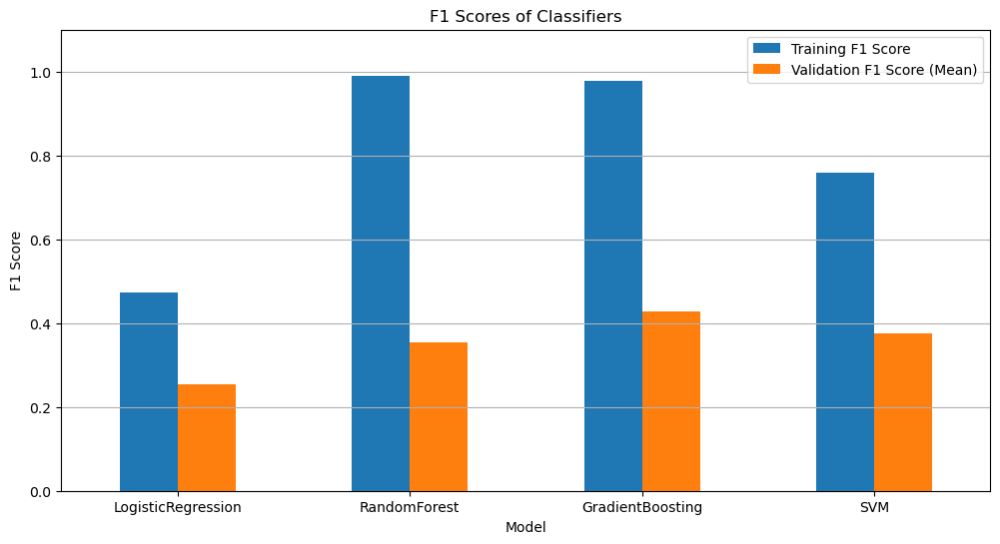

In [10]:
import matplotlib.pyplot as plt

# Bar Chart
results_df.set_index("Model")[["Training F1 Score", "Validation F1 Score (Mean)"]].plot.bar(figsize=(12, 6), rot=0)
plt.title("F1 Scores of Classifiers")
plt.ylabel("F1 Score")
plt.ylim(0, 1.1)
plt.grid(axis="y")
plt.show()

#### **6.1.3 Results Analysis**

The `results_df` summarizes the performance of four machine learning models on the deception storytelling dataset, showcasing their **training F1 scores** and **mean validation F1 scores** obtained through cross-validation. Here's a breakdown and analysis of the results:

**(a) Logistic Regression**:
- Logistic Regression, a simple linear model, serves as the baseline model in this project. This model with the hyperparameter option of "C" =1 and "max_iter"=100, has the lowest mean validation F1 score (0.2532) among all models, indicating that the extracted audio features are not linearly separable. This result is expected, as audio features are typically high-dimensional and complex, consisting of thousands of data points within each 30-second chunks. 

- Linear models like Logistic Regression tend to struggle with data because they assume a linear relationship between the features and the target labels, which may not capture the complex patterns inherent in audio signals. This performance provides a useful baseline to compare the effectiveness of more advanced, non-linear models like Random Forest, Gradient Boosting Classifiers and SVM.

- The disparity between training and validation F1 scores suggests overfitting, as the model performs better on the training set than on unseen validation data.

**(b) Random Forest**:
- Random Forest using the best hyperparameters chosen through GridSearchCV ("n_estimators"=10 and "max_depth"=10) achieves a very high training F1 score of 0.9892, indicating string learning from the training data. However, the validation F1 score drops significantly to 0.3537, suggesting overfitting.

- This overfitting is expected and common for Random Forest, because each decision tree in Random Forest memorize the training data rather than generalizing to unseen data. In this case, the limited number of training chunks (289) and the high-dimensional nature of the extracted audio features further exacerbate this overfitting tendency.

- Despite the overfitting, the higher validation F1 score compared to Logistic Regression suggests that Random Forest is better at capturing the non-linear relationships present in the audio features, such as pitch variability and energy fluctuations, which are likely to play a critical role in distinguishing between truthful and deceptive storytelling. 

**(c) Gradient Boosting**:
- Gradient Boosting, with the best hyperparameters (learning_rate=0.2, max_depth=3, n_estimators=50), achieves the highest validation F1 score (0.4279) among all models, indicating its ability to generalize better to unseen data. The smaller gap between the training F1 score (0.9784) and validation F1 score compared to Random Forest suggests that Gradient Boosting is less prone to overfitting. 
- However, the high training F1 score still points to some degree of overfitting, which could caused by the small audio dataset (289 chunks).

- Despite some overfitting, Gradient Boosting is the best classifiers in detecting the deceptive storytelling among the four models, as it effectively captures the nuances of non-linear relationships in the audio features based on its ability to handle imbalanced class like our audio datasets, combined with its flexibility in adjusting paramaters, like learning rate and tree depth. The lower max_depth (3) limits the tree complexity, enabling better generalization than other models.

**(d) Support Vector Machine (SVM)**:
- SVM, with the best hyperparameters (C=10, gamma='scale', kernel='rbf'), achieves a validation F1 score of 0.3757, outperforming Logistic Regression and Random Forest but falling short of Gradient Boosting. By using RBF (Radial Basis Function) kernel, SVM able to model non-linear relationships in the audio features effectively, improving its ability in detecting deceptive storytelling.

- The more moderate difference between training F1 score (0.7591) and validation F1 score (0.3757) suggests that SVM avoids overfitting better than Gradient Boosting and Random Forest. This model balances avoiding overfitting and capturing non-linear relationships, making it a moderately effective classifier in this project.

**Conclusion**:
- The Gradient Boosting Classifier is identified as the best model for the deceptive storytelling detection task in this project. This conclusion is based on its highest mean validation F1 score of 0.4279, outperforming Logistic Regression, Random Forest, and Support Vector Machine (SVM).

- Following the model selection process, the Gradient Boosting Classifier is tested on the unseen testing dataset to evaluate its performance and ability to generalize to new data, ensuring its robustness and reliability for real-world application


## **6.2 Model Testing**
- In this section, we evaluate the performance of the Gradient Boosting Classifier on the unseen testing dataset to assess its generalization ability, as it is the best-performing model based on cross-validated F1 scores during training and validation.

- The testing F1 score serves as the primary metric, reflecting the model's balance between precision and recall in handling both classes.

- A normalized confusion matrix was generated to provide additional insights into how well the model distinguishes between truthful and deceptive stories.

Test F1 Score: 0.4202


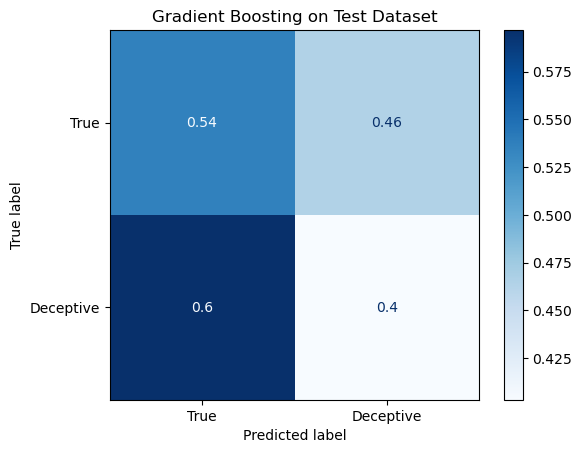

In [11]:
from sklearn.metrics import f1_score, confusion_matrix, ConfusionMatrixDisplay

best_gb_params = results_df.loc[results_df["Model"] == "GradientBoosting", "Best Params"].values[0]
best_gb_model = pipelines["GradientBoosting"].set_params(**best_gb_params)

best_gb_model.fit(X_train, y_train)  
y_test_pred = best_gb_model.predict(X_test)  
test_f1 = f1_score(y_test, y_test_pred)

print(f"Test F1 Score: {test_f1:.4f}")

# Confusion Matrix
cm = confusion_matrix(y_test, y_test_pred, normalize="true")
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=["True", "Deceptive"])
disp.plot(cmap="Blues")
plt.title("Gradient Boosting on Test Dataset")
plt.show()

### **6.2 Testing Results Analysis**

- The Gradient Boosting Classifier achieved a test F1 score of 0.4202 on the unseen dataset, closely aligning with its validation F1 score of 0.4279, indicating reasonable generalization. However, the confusion matrix shows that this models struggles to differentiate between true and deceptive stories.

- For deceptive stories, 40% were correctly classified, while 60% were misclassified as true. Similarly, for true stories, 54% were correctly classified, but 46% were misclassified as deceptive. These high false positive and false negative rates undermine both precision and recall, contributing to the final moderate F1 score. The nearly 50/50 prediction distribution for deceptive stories shows that the model lacks of confidence in distinguishing the two classes.

- Both false negatives and false positives carry serious implications in deception detection. False negatives allow deceptive stories to go undetected, while false positives unfairly flag truthful stories as deceptive, potentially leading to ethical and practical concerns. 

# **7. Conclusion and Suggestions**

### **7.1 Conclusion**

This project aimed to develop a machine learning model to detect deceptive storytelling based on 30-second audio segments. Four audio features—power, pitch mean, pitch standard deviation, and voice fraction—were extracted to train four machine learning classifiers: Logistic Regression, Random Forest, Gradient Boosting, and Support Vector Machine (SVM). Among these, Gradient Boosting demonstrated the best performance, achieving the highest mean validation F1 score of 0.4279, followed by SVM and Random Forest, while Logistic Regression showed the lowest mean validation F1 score of 0.2532. These results suggest that the audio features extracted are not linearly separable, requiring non-linear decision boundaries for effective classification.

Gradient Boosting was selected as the final model and evaluated on an unseen test dataset to assess its generalization performance. The model achieved a test F1 score of 0.4202, closely aligning with its validation F1 score, indicating reasonable generalization. However, the confusion matrix highlighted significant challenges in distinguishing between truthful and deceptive storytelling. The model’s 50/50 prediction split for deceptive stories indicates a lack of confidence in its predictions. Additionally, the high cost of false positives (truth misclassified as deceptive) and false negatives (deceptive misclassified as truth) remains a critical limitation, as false positives could penalize the innocent, while false negatives may allow the guilty to escape accountability.

The overall performance of the Gradient Boosting model reflects the inherent challenges of audio-based deception detection, particularly with a limited dataset and simple feature representation.


### **7.2 Suggestions for Improvement**

To improve the effectiveness of audio-based deception detection, several areas can be addressed. Firstly, the dataset used in this project was relatively small, with only 100 raw audio files and 420 valid 30-second chunks. This small sample size limits the generalizability of the models, especially in a high-variability domain like audio. Future efforts should focus on collecting larger datasets to better capture the variability in real-world scenarios.

Secondly, the four audio features used—power, pitch mean, pitch standard deviation, and voice fraction—may not fully capture the complexity of deception in audio. Incorporating more advanced features, such as MFCCs (Mel-Frequency Cepstral Coefficients) for richer frequency representation <sup>[1]</sup>, spectral features to capture dynamics in audio signals and prosodic features that may reveal subtle cues related to deception.<sup>[2]</sup>

While traditional classifiers like Gradient Boosting performed reasonably well, advanced models such as deep learning could capture more complex  patterns, such as LSTMs (Long Short-Term Memory) models which is been widely used in previous research <sup>[2]</sup>, as LSTMs can learn temporal dependencies and patterns across time.

By addressing these areas, the overall accuracy and reliability of deceptive storytelling detection is expected to be more enhanced, making the model more suitable for solving the real-world problems.

# **8. References**

1. Xue A, Rohde H, Finkelstein PA. *An acoustic automated lie detector.* Princeton University. 2019. 

2. Fernandes SV, Ullah MS. *A comprehensive review on features extraction and features matching techniques for deception detection.* IEEE Access. 2022 Mar 8;10:28233-46.

3. Scikit-Learn. *LogisticRegression* [Internet]. Available from: https://scikit-learn.org/1.5/modules/generated/sklearn.linear_model.LogisticRegression.html

4. Scikit-Learn. *RandomForestClassifier* [Internet]. Available from: https://scikit-learn.org/1.5/modules/generated/sklearn.ensemble.RandomForestClassifier.html

5. Scikit-Learn. *GradientBoostingClassifier* [Internet].Available from: https://scikit-learn.org/dev/modules/generated/sklearn.ensemble.GradientBoostingClassifier.html

6. Scikit-Learn. *SVC* [Internet].Available from: https://scikit-learn.org/dev/modules/generated/sklearn.svm.SVC.html

7. Code Basics, Dhaval Patel. *Banglore Home Prices*. 2015. Git Hub repository, https://github.com/codebasics/py/blob/master/DataScience/BangloreHomePrices/model/banglore_home_prices_final.ipynb
